In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
import cv2
from skimage import io
from skimage.filters import frangi
import skimage.morphology as mp
import nibabel as nib

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, optimizers
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers.legacy import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import plotly.express as px
import random
import glob
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, normalize
from IPython.display import display

2025-06-25 14:58:39.785644: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750863520.026239      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750863520.100554      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [3]:
import kagglehub

# === DOWNLOAD AND LOAD DATASET ===
path = kagglehub.dataset_download("himanshi549/datasetforpvsegmentation")

In [4]:
dataset_path = '/kaggle/input/datasetforpvsegmentation'

In [5]:
# === CREATE MASK OUTPUT DIRECTORIES ===
frangi_mask_path = './frangi_output_masks'
bgpvs_mask_path = './bgpvs_outputs'
os.makedirs(frangi_mask_path, exist_ok=True)
os.makedirs(bgpvs_mask_path, exist_ok=True)

In [6]:
# === FIXED: EXTRACT BACKGROUND ROI FUNCTION ===
def extract_bg_roi(seg):
    # Treat any non-zero region as ROI
    bg = (seg > 0).astype(np.uint8)
    bg = mp.binary_closing(bg, mp.ball(3))
    return bg


In [7]:
# === PROCESS ALL SUBJECTS FOR FRANGI FILTERING & BGPVS SEGMENTATION ===
subject_ids = sorted([f.replace('_T2w.nii', '') for f in os.listdir(dataset_path) if f.endswith('_T2w.nii')])
subject_ids = subject_ids[:50]
print("Subject IDs extracted:", subject_ids)

for sub_id in subject_ids:
    try:
        print(f"Processing {sub_id}...")

        t2_path = os.path.join(dataset_path, f"{sub_id}_T2w.nii")
        label_path = os.path.join(dataset_path, f"{sub_id}_desc-mask_PVS.nii")

        if not os.path.exists(t2_path) or not os.path.exists(label_path):
            print(f"Skipping {sub_id} due to missing files.")
            continue

        t2_img = nib.load(t2_path)
        t2_data = t2_img.get_fdata()
        seg_data = nib.load(label_path).get_fdata()

        bg = extract_bg_roi(seg_data)

        if np.count_nonzero(bg) == 0:
            print(f"Skipping {sub_id} — background ROI is empty.")
            continue

        t2_frangi = frangi(t2_data, sigmas=[1, 2], black_ridges=False)

        nib.save(nib.Nifti1Image(t2_frangi.astype(np.float32), t2_img.affine, t2_img.header),
                 os.path.join(frangi_mask_path, f"{sub_id}_frangi_mask.nii.gz"))

        t2_frangi[bg == 0] = 0

        if np.count_nonzero(t2_frangi) == 0:
            print(f"Skipping {sub_id} — no values left after masking.")
            continue

        bg_mean = np.mean(t2_frangi[bg == 1])
        bg_std = np.std(t2_frangi[bg == 1])
        bg_pvs = t2_frangi > (bg_mean + 1 * bg_std)
        bg_pvs = mp.binary_opening(bg_pvs, mp.ball(1))

        nib.save(nib.Nifti1Image(bg_pvs.astype(np.uint8), t2_img.affine, t2_img.header),
                 os.path.join(bgpvs_mask_path, f"{sub_id}_bgpvs.nii.gz"))

        voxel_vol = np.prod(t2_img.header['pixdim'][1:4])
        volume_mm3 = voxel_vol * np.count_nonzero(bg_pvs)
        print(f"  BG PVS volume: {volume_mm3:.2f} mm^3")

    except Exception as e:
        print(f"Error processing {sub_id}: {e}")

Subject IDs extracted: ['sub-001', 'sub-002', 'sub-003', 'sub-004', 'sub-005', 'sub-006', 'sub-007', 'sub-008', 'sub-009', 'sub-010', 'sub-011', 'sub-012', 'sub-013', 'sub-014', 'sub-015', 'sub-016', 'sub-017', 'sub-018', 'sub-019', 'sub-020', 'sub-021', 'sub-022', 'sub-023', 'sub-024', 'sub-025', 'sub-026', 'sub-027', 'sub-028', 'sub-029', 'sub-030', 'sub-031', 'sub-032', 'sub-033', 'sub-034', 'sub-035', 'sub-036', 'sub-037', 'sub-038', 'sub-039', 'sub-040', 'sub-041', 'sub-042', 'sub-043', 'sub-044', 'sub-045', 'sub-046', 'sub-047', 'sub-048', 'sub-049', 'sub-050']
Processing sub-001...
  BG PVS volume: 23.55 mm^3
Processing sub-002...
  BG PVS volume: 0.00 mm^3
Processing sub-003...
  BG PVS volume: 12.29 mm^3
Processing sub-004...
  BG PVS volume: 6.14 mm^3
Processing sub-005...
  BG PVS volume: 0.00 mm^3
Processing sub-006...
  BG PVS volume: 0.00 mm^3
Processing sub-007...
  BG PVS volume: 10.75 mm^3
Processing sub-008...
  BG PVS volume: 7.17 mm^3
Processing sub-009...
  BG PVS 

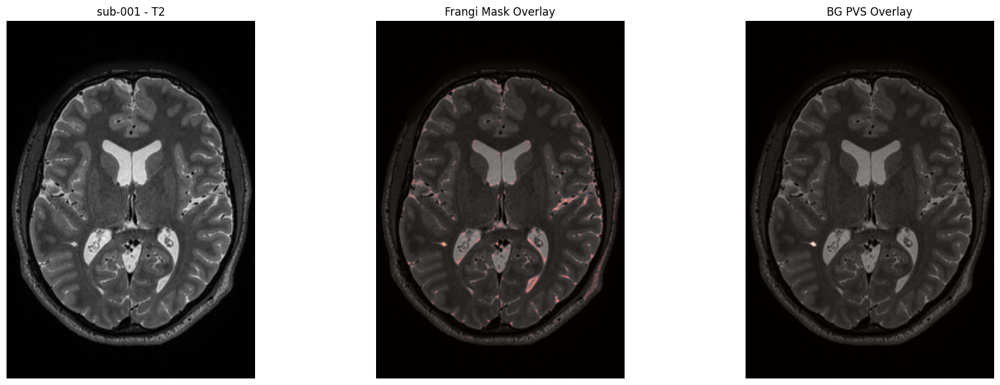

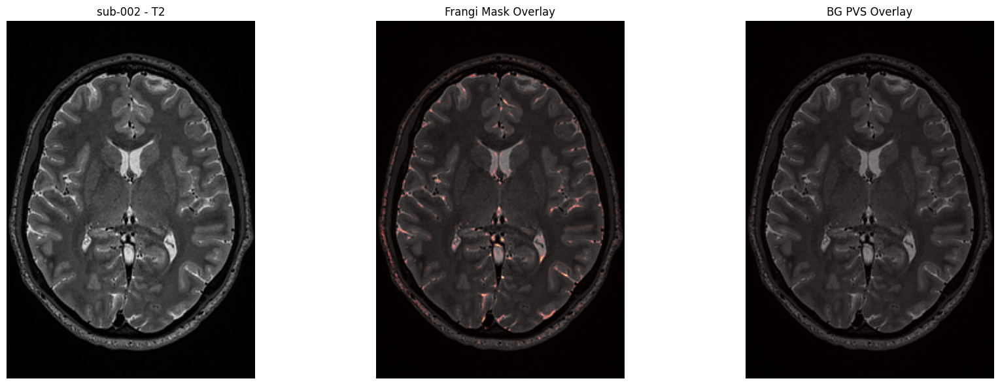

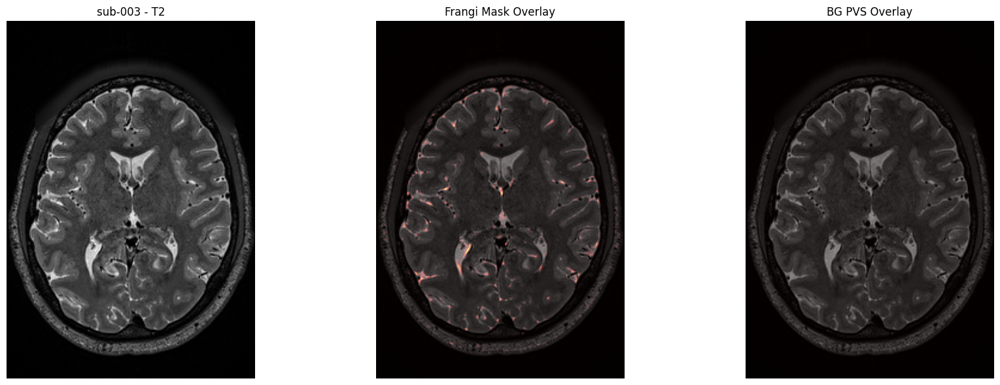

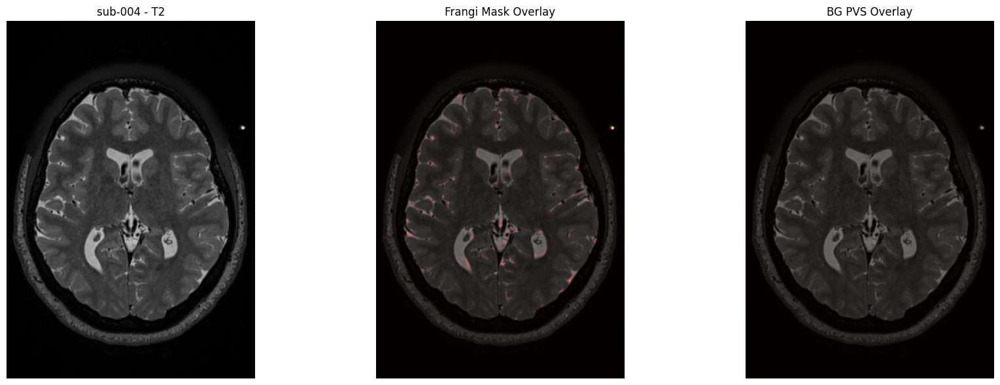

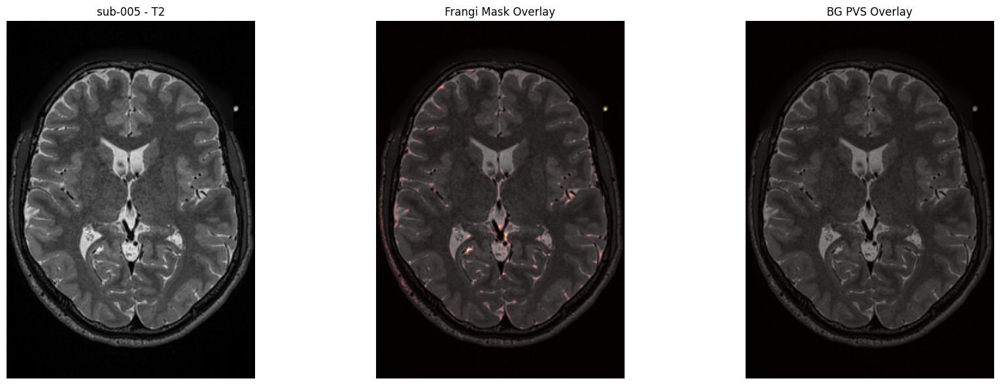

...

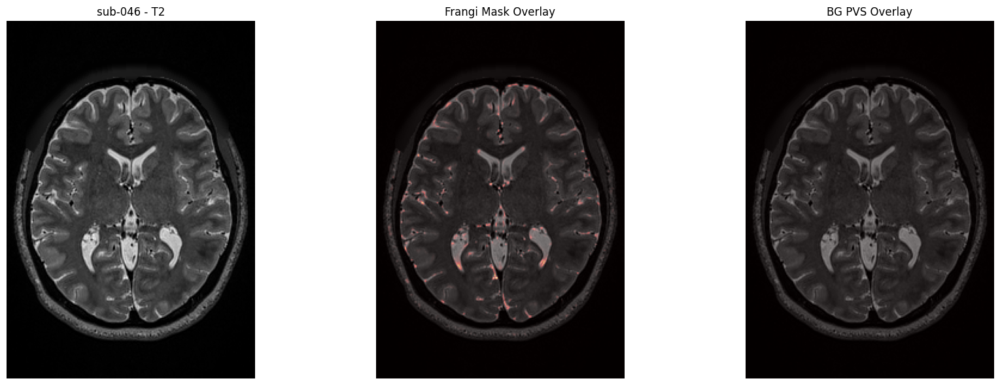

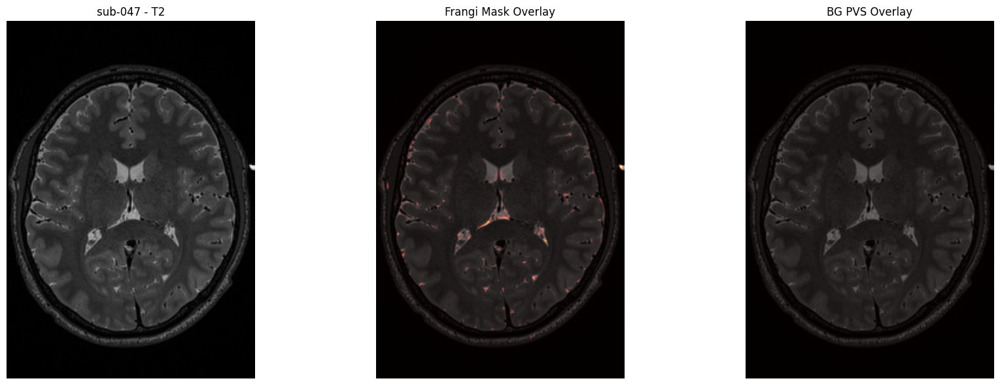

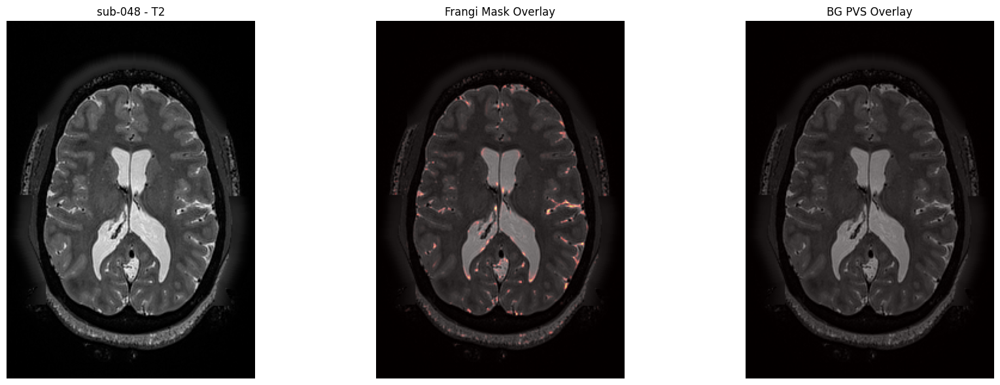

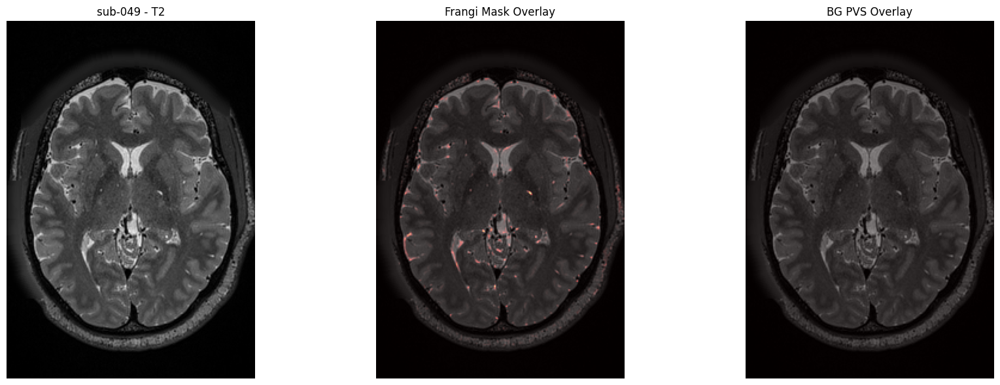

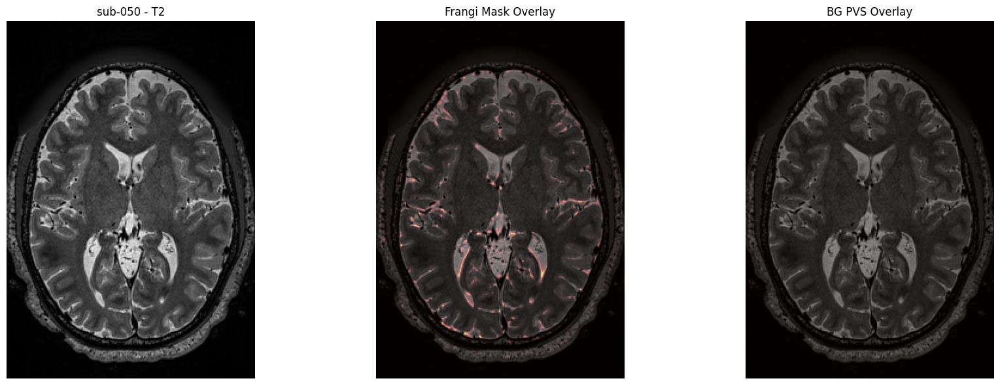

In [8]:
# === OPTIONAL VISUALIZATION ===
for sub_id in subject_ids:
    try:
        t2_path = os.path.join(dataset_path, f"{sub_id}_T2w.nii")
        frangi_mask_file = os.path.join(frangi_mask_path, f"{sub_id}_frangi_mask.nii.gz")
        bgpvs_mask_file = os.path.join(bgpvs_mask_path, f"{sub_id}_bgpvs.nii.gz")

        if not (os.path.exists(t2_path) and os.path.exists(frangi_mask_file) and os.path.exists(bgpvs_mask_file)):
            continue

        t2 = nib.load(t2_path).get_fdata()
        frangi_mask = nib.load(frangi_mask_file).get_fdata()
        bgpvs_mask = nib.load(bgpvs_mask_file).get_fdata()

        mid = t2.shape[2] // 2
        t2_slice = np.rot90(t2[:, :, mid])
        frangi_slice = np.rot90(frangi_mask[:, :, mid])
        bgpvs_slice = np.rot90(bgpvs_mask[:, :, mid])

        fig, ax = plt.subplots(1, 3, figsize=(18, 6))
        ax[0].imshow(t2_slice, cmap='gray')
        ax[0].set_title(f'{sub_id} - T2')
        ax[1].imshow(t2_slice, cmap='gray')
        ax[1].imshow(frangi_slice, cmap='hot', alpha=0.4)
        ax[1].set_title('Frangi Mask Overlay')
        ax[2].imshow(t2_slice, cmap='gray')
        ax[2].imshow(bgpvs_slice, cmap='hot', alpha=0.4)
        ax[2].set_title('BG PVS Overlay')
        for a in ax: a.axis('off')
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Visualization error for {sub_id}: {e}")